In [1]:
%pylab inline
from matplotlib import animation
from scipy.integrate import odeint
from numpy.linalg import norm
from IPython.display import HTML

Populating the interactive namespace from numpy and matplotlib


# Kuiper Belt Project
![alt text](kuiper-belt.png)
### What set(s) of initial conditions cause icy bodies from this region of our solar system to migrate inside Neptune's orbit and become sort period comets?

In [2]:
'''This function is a test function to get a working set of initial conditions for 
Neptunes orbit.'''
def f(s, t):
    #Define constants
    gM = 1.0; m = 0.1; #Just setting Neptune to have a mass 10% of the sun
    #Unpack the state
    r1 = s[0:2]; v1 = s[2:4];
    #Calculate the force of the sun on Neptune
    r = norm(r1)
    #For this I'm just utilizing the fact that rhat/|r|^2 = r/|r|^3 in Newton's law of gravity
    F = -gM*m*r1/(r**3) 
    #Return
    dsdt = concatenate([v1,F/m])
    return dsdt

In [3]:
#Setting Neptune's intitial conditions (For all initial conditions using arbitrary units)
s0 = np.array([1,0,0,1]) #Starts 1 Neptunian unit (30 AU)
ts = linspace(0,100,1000)
ans = odeint(f,s0,ts)

Text(0, 0.5, 'y Position (30 AU)')

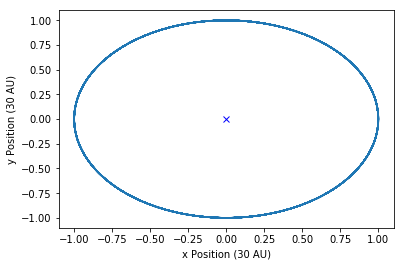

In [4]:
#Plotting the x pos vs. the y position
plot(0,0,'bx')
plot(ans[:,0],ans[:,1])
xlabel("x Position (30 AU)")
ylabel("y Position (30 AU)")

In [5]:
'''This function adds an addtional body to the system, and again is just a way to test 
the initial conditions for a "steady state"'''
def f(s, t):
    #Define constants
    gM = 1.0; G = 1.0; mN = 0.1; m = 0.00001;
    #Unpack the system
    rN = s[0:2]; vN = s[2:4];
    r1 = s[4:6]; v1 = s[6:8];
    #Calculate gravitational forces, here I'm just having the forces between the objects and the sun, not with each other
    F1 = -gM*m*r1/(norm(r1)**3 + 0.01)
    FN = -gM*mN*rN/(norm(rN)**3 + 0.01)
    dsdt = concatenate([vN, FN/mN, v1, F1/m])    
    return dsdt

In [6]:
s0 = np.array([1,0,0,1,2,0,0,0.7])
ts = linspace(0,100,1000)
ans = odeint(f,s0,ts)

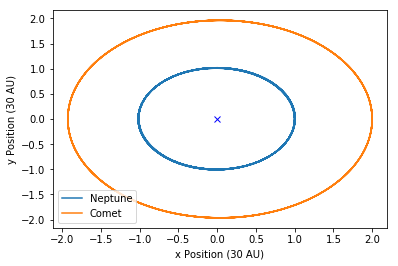

In [7]:
plot(0,0,'bx')
plot(ans[:,0],ans[:,1], label = "Neptune")
plot(ans[:,4],ans[:,5], label = "Comet")
xlabel("x Position (30 AU)")
ylabel("y Position (30 AU)")
legend(loc = 'lower left')

In [8]:
#This function adds onto the last one by adding a gravitational force between Neptune and the comet
def f(s, t):
    #Define constants
    gM = 1.0; G = 1.0; mN = 0.1; m = 0.00001;
    #Unpack the state
    rN = s[0:2]; vN = s[2:4];
    r1 = s[4:6]; v1 = s[6:8];
    #Forces with the sun
    F1 = -gM*m*r1/(norm(r1)**3 + 0.01)
    FN = -gM*mN*rN/(norm(rN)**3 + 0.01)
    #Force between the two objects
    r12 = r1 - rN; r = norm(r12);
    r12h = r12/r; r21h = -r12h;
    F = G*mN*m/r**2
    dsdt = concatenate([vN, (FN + F*r12h)/mN, v1, (F1 + F*r21h)/m])    
    return dsdt

In [9]:
s0 = np.array([1,0,0,1,2,0,0,0.7]) #Same as above for the case when they weren't interacting
ts = linspace(0,100,1000)
ans = odeint(f,s0,ts)

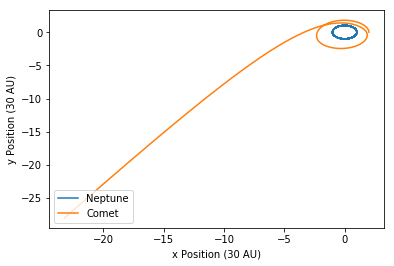

In [10]:
plot(ans[:,0],ans[:,1], label = "Neptune")
plot(ans[:,4],ans[:,5], label = "Comet")
xlabel("x Position (30 AU)")
ylabel("y Position (30 AU)")
legend(loc = 'lower left')

In [11]:
fig = figure(figsize=(6,6))
xlabel("x Position (30 AU)")
ylabel("y Position (30 AU)")
xlim(-3,3)
ylim(-3,3)

mass, = plot([], [], 'ro')
path1, = plot([],[],'b')
path2, = plot([],[],'orange')
origin, = plot(0,0,'bx')
plt.close()

def animate(i):
    i = int((ans.shape[0]-1)*i/99)
    mass.set_data(ans[i,[0,4]], ans[i,[1,5]])
    #spring.set_data(ans[i,[0,4]], ans[i,[1,5]])
    path1.set_data(ans[:i,0], ans[:i,1])
    path2.set_data(ans[:i,4], ans[:i,5])
    return path2,

ani = animation.FuncAnimation(fig, animate, frames=100, interval=20, blit=True)
HTML(ani.to_jshtml())

In [12]:
'''When the gravitational force between Neptune and the comet is added, the perturbation in 
the comets orbit actually stems from a gravitational assist from Neptune.'''

'When the gravitational force between Neptune and the comet is added, the perturbation in \nthe comets orbit actually stems from a gravitational assist from Neptune.'

In [13]:
#Here I'm setting the comet to be halfway in the belt and slowing down it's initial vel.
s0 = np.array([1,0,0,1,1.5,0,0,0.5])
ts = linspace(0,100,1000)
ans = odeint(f,s0,ts)

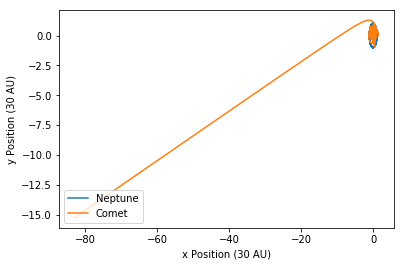

In [14]:
plot(ans[:,0],ans[:,1], label = "Neptune")
plot(ans[:,4],ans[:,5], label = "Comet")
xlabel("x Position (30 AU)")
ylabel("y Position (30 AU)")
legend(loc = 'lower left')

In [15]:
fig = figure(figsize=(6,6))
xlabel("x Position (30 AU)")
ylabel("y Position (30 AU)")
xlim(-4,4)
ylim(-4,4)

mass, = plot([], [], 'ro')
path1, = plot([],[],'b')
path2, = plot([],[],'orange')
origin, = plot(0,0,'bx')
plt.close()

def animate(i):
    i = int((ans.shape[0]-1)*i/99)
    mass.set_data(ans[i,[0,4]], ans[i,[1,5]])
    #spring.set_data(ans[i,[0,4]], ans[i,[1,5]])
    path1.set_data(ans[:i,0], ans[:i,1])
    path2.set_data(ans[:i,4], ans[:i,5])
    return path2,

ani = animation.FuncAnimation(fig, animate, frames=100, interval=20, blit=True)
HTML(ani.to_jshtml())

In [16]:
'''Here when the comet is both closer and initial slower, we see that it quickly falls into
Neptune's orbit and becomes a sort period comet until it gets launched out. So if a comet's
momentum in the Kuiper belt somehow decreased (maybe through a collision with another)
and it is close enough to Neptune's orbit, it could become a short period comet'''

"Here when the comet is both closer and initial slower, we see that it quickly falls into\nNeptune's orbit and becomes a sort period comet until it gets launched out. So if a comet's\nmomentum in the Kuiper belt somehow decreased (maybe through a collision with another)\nand it is close enough to Neptune's orbit, it could become a short period comet"

In [17]:
#To get a more "stable" orbit, keeping at the edges of the belt with a slower initial vel.
s0 = np.array([1,0,0,1,2,0,0,0.5])
ts = linspace(0,100,1000)
ans = odeint(f,s0,ts)

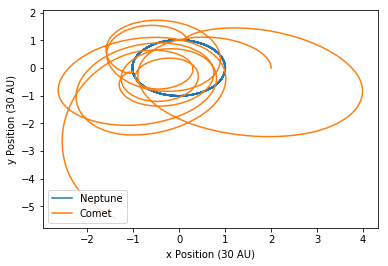

In [18]:
plot(ans[:,0],ans[:,1], label = "Neptune")
plot(ans[:,4],ans[:,5], label = "Comet")
xlabel("x Position (30 AU)")
ylabel("y Position (30 AU)")
legend(loc = 'lower left')

In [19]:
fig = figure(figsize=(6,6))
xlabel("x Position (30 AU)")
ylabel("y Position (30 AU)")
xlim(-4,4)
ylim(-4,4)

mass, = plot([], [], 'ro')
path1, = plot([],[],'b')
path2, = plot([],[],'orange')
origin, = plot(0,0,'bx')
plt.close()

def animate(i):
    i = int((ans.shape[0]-1)*i/99)
    mass.set_data(ans[i,[0,4]], ans[i,[1,5]])
    #spring.set_data(ans[i,[0,4]], ans[i,[1,5]])
    path1.set_data(ans[:i,0], ans[:i,1])
    path2.set_data(ans[:i,4], ans[:i,5])
    return path2,

ani = animation.FuncAnimation(fig, animate, frames=100, interval=20, blit=True)
HTML(ani.to_jshtml())

In [20]:
'''In the case where it still has a slower velocity, but is now further out, the same results
still apply, however it doesn't approach the sun as closely as before.'''

"In the case where it still has a slower velocity, but is now further out, the same results\nstill apply, however it doesn't approach the sun as closely as before."

In [21]:
'''This function has three bodies in total, 2 comets and then Neptune. No forces on each other
to search for "steady state"'''
def f(s, t):
    #Define constants
    gM = 1.0; G = 1.0; mN = 0.1; m1 = 0.00001; m2 = 0.00001;
    #Unpack the system
    rN = s[0:2]; vN = s[2:4];
    r1 = s[4:6]; v1 = s[6:8];
    r2 = s[8:10]; v2 = s[10:12];
    #Calculate gravitational forces, here I'm just having the forces between the objects and the sun, not with each other
    F1 = -gM*m1*r1/(norm(r1)**3 + 0.0001)
    F2 = -gM*m2*r2/(norm(r2)**3 + 0.0001)
    FN = -gM*mN*rN/(norm(rN)**3 + 0.0001)
    dsdt = concatenate([vN, FN/mN, v1, F1/m1, v2, F2/m2])    
    return dsdt

In [22]:
s0 = np.array([1,0,0,1,1.5,0,0,0.81,2,0,0,0.7])
ts = linspace(0,1000,10000)
ans = odeint(f,s0,ts)

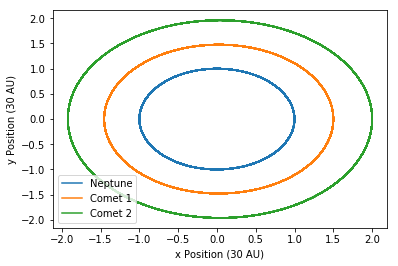

In [23]:
plot(ans[:,0],ans[:,1], label = "Neptune")
plot(ans[:,4],ans[:,5], label = "Comet 1")
plot(ans[:,8],ans[:,9], label = "Comet 2")
xlabel("x Position (30 AU)")
ylabel("y Position (30 AU)")
legend(loc = 'lower left')

In [24]:
'''Adding in the forces between the three objects. Anything with an N refers to Neptune, and 
the comets are 1 and 2.'''
def f(s, t):
    #Define constants
    gM = 1.0; G = 1.0; mN = 0.10; m1 = 0.00001; m2 = 0.00001;
    #Unpack the state
    rN = s[0:2]; vN = s[2:4];
    r1 = s[4:6]; v1 = s[6:8];
    r2 = s[8:10]; v2 = s[10:12];
    #Forces with the sun
    F1 = -gM*m1*r1/(norm(r1)**3 + 0.001)
    F2 = -gM*m2*r2/(norm(r2)**3 + 0.001)
    FN = -gM*mN*rN/(norm(rN)**3 + 0.001)
    #Forces between the three objects
    r12 = r2 - r1; #distance between the two comets
    r1N = r1 - rN; #comet one and Neptune
    r2N = r2 - rN; #comet two and Neptune
    r = norm(r12); r1Nmag = norm(r1N); r2Nmag = norm(r2N);
    #For the rhats, r1Nh and r2Nh are for Neptunes direction
    r12h = r12/r; r21h = -r12h; r1Nh = r1N / r1Nmag; rNh1 = -r1Nh; r2Nh = r2N/r2Nmag; rNh2 = -r2Nh;
    F1N = G*mN*m1/(r1N**2+0.001) #Force between Neptune and comet one
    F2N = G*mN*m1/(r2N**2+0.001) #Force between Neptune and comet two
    F = G*m1*m2/(r**2+0.01) #Force between the two comets
    #Returning the added the forces together with the correct rhat for each body
    dsdt = concatenate([vN, (FN + F1N*r1Nh + F2N*r2Nh)/mN, v1, (F1 + F1N*rNh1 + F*r12h)/m1, 
                        v2, (F2 + F2N*rNh2 + F*r21h)/m2])    
    return dsdt

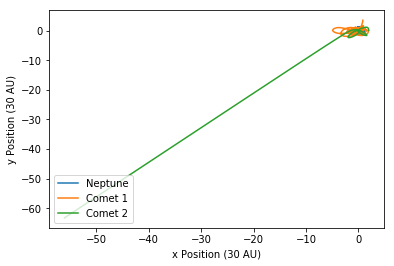

In [25]:
s0 = np.array([1,0,0,1,1.5,0,0,0.82,2,0,0,0.7]) #Same as above
ts = linspace(0,100,1000)
ans = odeint(f,s0,ts)
plot(0,0,'bx')
plot(ans[:,0],ans[:,1], label = "Neptune")
plot(ans[:,4],ans[:,5], label = "Comet 1")
plot(ans[:,8],ans[:,9], label = "Comet 2")
xlabel("x Position (30 AU)")
ylabel("y Position (30 AU)")
legend(loc = 'lower left')

In [26]:
fig = figure(figsize=(6,6))
xlabel("x Position (30 AU)")
ylabel("y Position (30 AU)")
xlim(-4,4)
ylim(-4,4)

mass, = plot([], [], 'ro')
path1, = plot([],[],'b')
path2, = plot([],[],'orange')
path3, = plot([],[],'green')
origin, = plot(0,0,'bx')
plt.close()

def animate(i):
    i = int((ans.shape[0]-1)*i/99)
    mass.set_data(ans[i,[0,4,8]], ans[i,[1,5,9]])
    #spring.set_data(ans[i,[0,4]], ans[i,[1,5]])
    path1.set_data(ans[:i,0], ans[:i,1])
    path2.set_data(ans[:i,4], ans[:i,5])
    path3.set_data(ans[:i,8], ans[:i,9])
    return path2,

ani = animation.FuncAnimation(fig, animate, frames=100, interval=20, blit=True)
HTML(ani.to_jshtml())

In [27]:
'''Here they both fall in fairly quickly (the green orbit maybe too quickly perhaps) 
and the further comet actual gets boosted out of the system quicker than the first.
Could be the intitial conditions, or something might be off with the calculations.'''

'Here they both fall in fairly quickly (the green orbit maybe too quickly perhaps) \nand the further comet actual gets boosted out of the system quicker than the first.\nCould be the intitial conditions, or something might be off with the calculations.'

In [28]:
def f(s, t):
    #Define constants
    gM = 1.0; G = 1.0; mN = 0.10; m1 = 0.00001; m2 = 0.01; #Note the mass change
    #Unpack the state
    rN = s[0:2]; vN = s[2:4];
    r1 = s[4:6]; v1 = s[6:8];
    r2 = s[8:10]; v2 = s[10:12];
    #Forces with the sun
    F1 = -gM*m1*r1/(norm(r1)**3 + 0.001)
    F2 = -gM*m2*r2/(norm(r2)**3 + 0.001)
    FN = -gM*mN*rN/(norm(rN)**3 + 0.001)
    #Forces between the three objects
    r12 = r2 - r1; r1N = r1 - rN; r2N = r2 - rN;
    r = norm(r12); r1Nmag = norm(r1N); r2Nmag = norm(r2N);
    r12h = r12/r; r21h = -r12h; r1Nh = r1N / r1Nmag; rNh1 = -r1Nh; r2Nh = r2N/r2Nmag; rNh2 = -r2Nh;
    F1N = G*mN*m1/(r1N**2+0.001)
    F2N = G*mN*m1/(r2N**2+0.001)
    F = G*m1*m2/(r**2+0.001)
    dsdt = concatenate([vN, (FN + F1N*r1Nh + F2N*r2Nh)/mN, v1, (F1 + F1N*rNh1 + F*r12h)/m1, 
                        v2, (F2 + F2N*rNh2 + F*r21h)/m2])    
    return dsdt

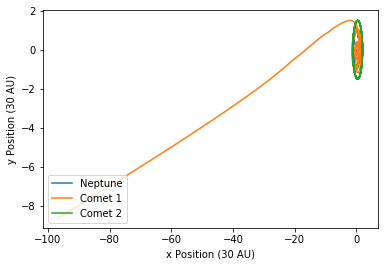

In [29]:
s0 = np.array([1,0,0,1,1.5,0,0,0.52,2,0,0,0.6])
ts = linspace(0,100,1000)
ans = odeint(f,s0,ts)
plot(0,0,'bx')
plot(ans[:,0],ans[:,1], label = "Neptune")
plot(ans[:,4],ans[:,5], label = "Comet 1")
plot(ans[:,8],ans[:,9], label = "Comet 2")
xlabel("x Position (30 AU)")
ylabel("y Position (30 AU)")
legend(loc = 'lower left')

In [30]:
fig = figure(figsize=(6,6))
xlabel("x Position (30 AU)")
ylabel("y Position (30 AU)")
xlim(-4,4)
ylim(-4,4)

mass, = plot([], [], 'ro')
path1, = plot([],[],'b')
path2, = plot([],[],'orange')
path3, = plot([],[],'green')
origin, = plot(0,0,'bx')
plt.close()

def animate(i):
    i = int((ans.shape[0]-1)*i/99)
    mass.set_data(ans[i,[0,4,8]], ans[i,[1,5,9]])
    #spring.set_data(ans[i,[0,4]], ans[i,[1,5]])
    path1.set_data(ans[:i,0], ans[:i,1])
    path2.set_data(ans[:i,4], ans[:i,5])
    path3.set_data(ans[:i,8], ans[:i,9])
    return path2,

ani = animation.FuncAnimation(fig, animate, frames=100, interval=20, blit=True)
HTML(ani.to_jshtml())

In [31]:
'''When the mass of the second is increased, we see that it falls into a regular orbit, 
but the inner comet becomes a moon of Neptune for awhile before becoming a short period
comet and eventually being boosted out of the system. One thing I noticed, was that when
the green comet and Neptune were close together, they didn't interact as much as I thought
they would, not sure if that comes from the fudge factor or something else.'''

"When the mass of the second is increased, we see that it falls into a regular orbit, \nbut the inner comet becomes a moon of Neptune for awhile before becoming a short period\ncomet and eventually being boosted out of the system. One thing I noticed, was that when\nthe green comet and Neptune were close together, they didn't interact as much as I thought\nthey would, not sure if that comes from the fudge factor or something else."

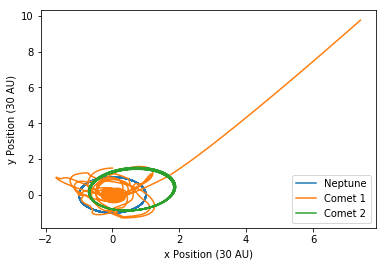

In [32]:
#Setting up the conditions so that they start at different points along the plane
r1 = 1.5; r2 = 2;
theta1 = pi/2; theta2 = pi/6;
v1 = 0.6; v2 = 0.5;
s0 = np.array([1,0,0,1,r1*cos(theta1),r1*sin(theta1),-v1*sin(theta1),v1*cos(theta1),
               r2*cos(theta2),r2*sin(theta2),-v2*sin(theta2),v2*cos(theta2)])
ts = linspace(0,100,1000)
ans = odeint(f,s0,ts)
plot(0,0,'bx')
plot(ans[:,0],ans[:,1], label = "Neptune")
plot(ans[:,4],ans[:,5], label = "Comet 1")
plot(ans[:,8],ans[:,9], label = "Comet 2")
xlabel("x Position (30 AU)")
ylabel("y Position (30 AU)")
legend(loc = 'lower right')

In [33]:
fig = figure(figsize=(6,6))
xlabel("x Position (30 AU)")
ylabel("y Position (30 AU)")
xlim(-4,4)
ylim(-4,4)

mass, = plot([], [], 'ro')
path1, = plot([],[],'b')
path2, = plot([],[],'orange')
path3, = plot([],[],'green')
origin, = plot(0,0,'bx')
plt.close()

def animate(i):
    i = int((ans.shape[0]-1)*i/99)
    mass.set_data(ans[i,[0,4,8]], ans[i,[1,5,9]])
    #spring.set_data(ans[i,[0,4]], ans[i,[1,5]])
    path1.set_data(ans[:i,0], ans[:i,1])
    path2.set_data(ans[:i,4], ans[:i,5])
    path3.set_data(ans[:i,8], ans[:i,9])
    return path2,

ani = animation.FuncAnimation(fig, animate, frames=100, interval=20, blit=True)
HTML(ani.to_jshtml())

In [34]:
'''After a long while of messing with the intitial conditions, we get a result that more or less
maximizes the time that a smaller comet would be thrown into the inner solar system and potentially 
wreck havec on Earth.... if only the Dinosaurs had this code...'''

'After a long while of messing with the intitial conditions, we get a result that more or less\nmaximizes the time that a smaller comet would be thrown into the inner solar system and potentially \nwreck havec on Earth.... if only the Dinosaurs had this code...'